In [1]:
import os
import random
import sys
import warnings
import numpy as np
import pandas as pd
from itertools import chain
from skimage.io import imread, imsave, imshow, imread_collection, concatenate_images
from skimage.color import gray2rgb
from skimage.transform import resize
from skimage.morphology import label
from keras.utils import Progbar

from keras.models import Model, load_model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from keras.layers.core import Dropout, Lambda, Activation
from keras.layers.convolutional import Conv2D, Conv2DTranspose,Convolution2D
from keras.layers.pooling import MaxPooling2D
from keras.layers.merge import concatenate
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import backend as K
from keras.optimizers import Adam, Adamax, Nadam, RMSprop
from keras.layers.normalization import BatchNormalization
import time
import cv2

from dataset_stage2 import DSB18Dataset, _DEFAULT_DS_NUCLEI_VAL_TEST_OPTIONS, _DEFAULT_DS_CONTOURS_VAL_TEST_OPTIONS
from post_stage2 import Post, _DEFAULT_PROC_OPTIONS
from visualize import display_sem_label_gt_vs_pred, display_sem_label_gt_and_pred
from visualize import display_image_and_pred_sem_label, display_image_and_pred_masks
from submission_stage2 import DSB18Submission

# Import cyclic LR
from clr_callback import *

warnings.filterwarnings('ignore', category=UserWarning, module='skimage')

# Setting seed for reproducability
seed = 42
random.seed = seed
# np.random.seed = seed
smooth = 1.
#epochs = 48
#epochs = 50
#epochs = 70
#epochs = 150
epochs = 300

# Number of test samples to display in notebook
num_samples = 100

e:\toolkits.win\anaconda3-5.1.0\envs\dlwin36\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
# See https://www.tensorflow.org/tutorials/using_gpu#allowing_gpu_memory_growth
import tensorflow as tf
config = tf.ConfigProto()
config.gpu_options.allow_growth = True

In [3]:
# Note: You MUST set dataset_root to the correct path on your machine!
if sys.platform.startswith("win"):
    dataset_root = "E:/datasets/dsb18.retrain"
else:
    dataset_root = "/media/EDrive/datasets/dsb18.retrain"
TRAIN_PATH = dataset_root + "/stage1_train/"
TEST_PATH = dataset_root + "/stage2_test_final/"

In [4]:
import glob

train_folder = TRAIN_PATH
samples = glob.glob(train_folder+'/**/')
n_samples = len(samples)
print ('number of samples:',n_samples)
print(samples[0])

number of samples: 729
E:/datasets/dsb18.retrain/stage1_train\00071198d059ba7f5914a526d124d28e6d010c92466da21d4a04cd5413362552\


In [5]:
# Get train and test IDs
train_ids = next(os.walk(TRAIN_PATH))[1]
test_ids = next(os.walk(TEST_PATH))[1]

In [6]:
# Function read train images and mask return as nump array
def read_train_data(IMG_WIDTH=256,IMG_HEIGHT=256,IMG_CHANNELS=3):
    X_train = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
    Y_train = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
    print('Getting and resizing train images and masks ... ')
    sys.stdout.flush()

    if os.path.isfile("train_img_256x256_retrained.npy"):
        print("Train file train_img_256x256_retrained.npy loaded from memory")
        X_train = np.load("train_img_256x256_retrained.npy")
    else:
        a = Progbar(len(train_ids))
        for n, id_ in enumerate(train_ids):
            path = TRAIN_PATH + id_
            img = imread(path + '/images/' + id_ + '.png')
            if len(img.shape) == 2:
                img = gray2rgb(img)
                if img.dtype == np.uint16:
                    img = (img // 255).astype(np.uint8)
            else:
                img = img[:,:,:IMG_CHANNELS]
            img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
            X_train[n] = img
            a.update(n)
        np.save("train_img_256x256_retrained.npy",X_train)
        
    if os.path.isfile("train_mask_256x256_retrained.npy"):
        print("Train file train_mask_256x256_retrained.npy loaded from memory")
        Y_train = np.load("train_mask_256x256_retrained.npy")
    else:
        a = Progbar(len(train_ids))
        for n, id_ in enumerate(train_ids):
            path = TRAIN_PATH + id_
            mask = np.zeros((IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
            for mask_file in next(os.walk(path + '/masks/'))[2]:
                mask_ = imread(path + '/masks/' + mask_file)
                mask_ = np.expand_dims(resize(mask_, (IMG_HEIGHT, IMG_WIDTH), mode='constant', 
                                            preserve_range=True), axis=-1)
                mask = np.maximum(mask, mask_)
            Y_train[n] = mask
            a.update(n)
        np.save("train_mask_256x256_retrained.npy",Y_train)
        
    return X_train,Y_train

In [7]:
# Function read train images and contours return as nump array
def read_train_contour_data(IMG_WIDTH=256,IMG_HEIGHT=256,IMG_CHANNELS=3):
    X_train = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
    Y_train = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
    print('Getting and resizing train images and masks ... ')
    sys.stdout.flush()

    if os.path.isfile("train_img_256x256_retrained.npy"):
        print("Train file train_img_256x256_retrained.npy loaded from memory")
        X_train = np.load("train_img_256x256_retrained.npy")
    else:
        a = Progbar(len(train_ids))
        for n, id_ in enumerate(train_ids):
            path = TRAIN_PATH + id_
            img = imread(path + '/images/' + id_ + '.png')
            if len(img.shape) == 2:
                img = gray2rgb(img)
                if img.dtype == np.uint16:
                    img = (img // 255).astype(np.uint8)
            else:
                img = img[:,:,:IMG_CHANNELS]
            img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
            X_train[n] = img
            a.update(n)
        np.save("train_img_256x256_retrained.npy",X_train)
        
    if os.path.isfile("train_2px_contours_256x256_retrained.npy"):
        print("Train file train_2px_contours_256x256_retrained.npy loaded from memory")
        Y_train = np.load("train_2px_contours_256x256_retrained.npy")
    else:
        a = Progbar(len(train_ids))
        for n, id_ in enumerate(train_ids):
            path = TRAIN_PATH + id_
            mask = imread(path + '/contours_2px/' + id_ + '.png')
            mask = resize(mask, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
            mask = np.expand_dims(mask, axis=-1)
            Y_train[n] = mask.astype(np.bool)
            a.update(n)
        np.save("train_2px_contours_256x256_retrained.npy",Y_train)
        
    return X_train,Y_train

In [8]:
# Function to read test images and return as numpy array
def read_test_data(IMG_WIDTH=256,IMG_HEIGHT=256,IMG_CHANNELS=3):
    X_test = np.zeros((len(test_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
    sizes_test = []
    print('\nGetting and resizing test images ... ')
    sys.stdout.flush()
    if os.path.isfile("test_img_256x256_retrained.npy") and os.path.isfile("test_size_256x256_retrained.npy"):
        print("Test file loaded from memory")
        X_test = np.load("test_img_256x256_retrained.npy")
        sizes_test = np.load("test_size_256x256_retrained.npy")
        return X_test,sizes_test
    b = Progbar(len(test_ids))
    for n, id_ in enumerate(test_ids):
        path = TEST_PATH + id_
        img = imread(path + '/images/' + id_ + '.png')
        if len(img.shape) == 2:
            img = gray2rgb(img)
            if img.dtype == np.uint16:
                img = (img // 255).astype(np.uint8)
        else:
            img = img[:,:,:IMG_CHANNELS]
        sizes_test.append([img.shape[0], img.shape[1]])
        img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
        X_test[n] = img
        b.update(n)
    np.save("test_img_256x256_retrained.npy",X_test)
    np.save("test_size_256x256_retrained.npy",sizes_test)
    return X_test,sizes_test

In [9]:
# Run-length encoding stolen from https://www.kaggle.com/rakhlin/fast-run-length-encoding-python
def rle_encoding(x):
    dots = np.where(x.T.flatten() == 1)[0]
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b + 1, 0))
        run_lengths[-1] += 1
        prev = b
    return run_lengths

def prob_to_rles(x, cutoff=0.5):
    lab_img = label(x > cutoff)
    for i in range(1, lab_img.max() + 1):
        yield rle_encoding(lab_img == i)

In [10]:
# Iterate over the test IDs and generate run-length encodings for each seperate mask identified by skimage
def mask_to_rle(preds_test_upsampled):
    new_test_ids = []
    rles = []
    for n, id_ in enumerate(test_ids):
        rle = list(prob_to_rles(preds_test_upsampled[n]))
        rles.extend(rle)
        new_test_ids.extend([id_] * len(rle))
    return new_test_ids,rles

In [11]:
# Metric function
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

# Loss funtion
def dice_coef_loss(y_true, y_pred):
    return -dice_coef(y_true, y_pred)

In [12]:
# Number of image channels (for example 3 in case of RGB, or 1 for grayscale images)
INPUT_CHANNELS = 3
# Number of output masks (1 in case you predict only one type of objects)
OUTPUT_MASK_CHANNELS = 1

def double_conv_layer(x, size, dropout, batch_norm):
    axis = 3
    conv = Conv2D(size, (3, 3), padding='same')(x)
    if batch_norm is True:
        conv = BatchNormalization(axis=axis)(conv)
    conv = Activation('relu')(conv)
    conv = Conv2D(size, (3, 3), padding='same')(conv)
    if batch_norm is True:
        conv = BatchNormalization(axis=axis)(conv)
    conv = Activation('relu')(conv)
    if dropout > 0:
        conv = Dropout(dropout)(conv)
    return conv

def get_unet(IMG_WIDTH=256,IMG_HEIGHT=256,IMG_CHANNELS=3, dropout_val=0.0, batch_norm=True):
    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
    s = Lambda(lambda x: x / 255) (inputs)

    filters = 32
    axis = 3

    conv_224 = double_conv_layer(inputs, filters, dropout_val, batch_norm)
    pool_112 = MaxPooling2D(pool_size=(2, 2))(conv_224)

    conv_112 = double_conv_layer(pool_112, 2*filters, dropout_val, batch_norm)
    pool_56 = MaxPooling2D(pool_size=(2, 2))(conv_112)

    conv_56 = double_conv_layer(pool_56, 4*filters, dropout_val, batch_norm)
    pool_28 = MaxPooling2D(pool_size=(2, 2))(conv_56)

    conv_28 = double_conv_layer(pool_28, 8*filters, dropout_val, batch_norm)
    pool_14 = MaxPooling2D(pool_size=(2, 2))(conv_28)

    conv_14 = double_conv_layer(pool_14, 16*filters, dropout_val, batch_norm)
    pool_7 = MaxPooling2D(pool_size=(2, 2))(conv_14)

    conv_7 = double_conv_layer(pool_7, 32*filters, dropout_val, batch_norm)

    up_14 = concatenate([UpSampling2D(size=(2, 2))(conv_7), conv_14], axis=axis)
    up_conv_14 = double_conv_layer(up_14, 16*filters, dropout_val, batch_norm)

    up_28 = concatenate([UpSampling2D(size=(2, 2))(up_conv_14), conv_28], axis=axis)
    up_conv_28 = double_conv_layer(up_28, 8*filters, dropout_val, batch_norm)

    up_56 = concatenate([UpSampling2D(size=(2, 2))(up_conv_28), conv_56], axis=axis)
    up_conv_56 = double_conv_layer(up_56, 4*filters, dropout_val, batch_norm)

    up_112 = concatenate([UpSampling2D(size=(2, 2))(up_conv_56), conv_112], axis=axis)
    up_conv_112 = double_conv_layer(up_112, 2*filters, dropout_val, batch_norm)

    up_224 = concatenate([UpSampling2D(size=(2, 2))(up_conv_112), conv_224], axis=axis)
    up_conv_224 = double_conv_layer(up_224, filters, 0, batch_norm)

    conv_final = Conv2D(OUTPUT_MASK_CHANNELS, (1, 1))(up_conv_224)
    conv_final = BatchNormalization(axis=axis)(conv_final)
    conv_final = Activation('sigmoid')(conv_final)

   # model = Model(inputs, conv_final, name="YTS_UNET_224")

   # outputs = Conv2D(1, (1, 1), activation='sigmoid') (c9)

    model = Model(inputs=[inputs], outputs=[conv_final], name="YTS_UNET_224")
    #myoptim = Adam(lr=0.0009, decay=0.0)
    #myoptim = Adam(lr=0.001, decay=0.0)
    #myoptim = Adamax(lr=0.002, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0)
    #myoptim = Adamax(lr=0.003, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.001)
    #myoptim = Adamax(lr=0.0018, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0)
    myoptim = Adamax(lr=0.002, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, clipnorm=5.0)
    model.compile(optimizer=myoptim,loss='binary_crossentropy', metrics=[dice_coef])
    return model

## Train nuclei semantic segmentation

In [13]:
# get train_data
train_img,train_mask = read_train_data()

# get test_data
test_img,test_img_sizes = read_test_data()

Getting and resizing train images and masks ... 
694/729 [===========================>..] - ETA:  - ETA: 17 - ETA: 15 - ETA: 14 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 15 - ETA: 16 - ETA: 16 - ETA: 16 - ETA: 15 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - 

2285/3019 [=====================>........] - ETA:  - ETA: 2: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 59

3017/3019 [============================>.] - ETA: 16 - ETA: 16 - ETA: 16 - ETA: 16 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 15 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 14 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 13 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 12 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 11 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 10 - ETA: 

In [14]:
# get u_net model
u_net = get_unet()

In [15]:
t0 = time.time()

# fit model on train_data
print("\nTraining...")
#u_net.fit(train_img,train_mask,batch_size=16,epochs=epochs)
# Fit model
clr_triangular = CyclicLR(mode='exp_range', gamma=0.99994) # Add cyclic LR
earlystopper = EarlyStopping(patience=20, verbose=1)
# Reload for cyclic LR finetuning
# u_net.load_weights("model_train_unet_512x512_nuclei.h5")
checkpointer = ModelCheckpoint('model_retrained_unet_256x256_nuclei_cyclic_lr.h5', verbose=1, save_best_only=True)
# checkpointer = ModelCheckpoint('model_train_unet_256x256_nuclei.h5', verbose=1, save_best_only=True)
results = u_net.fit(train_img, train_mask, validation_split=0.1, batch_size=8, epochs=epochs, 
                    callbacks=[clr_triangular, earlystopper, checkpointer])

t1 = time.time()                                                                              
total = t1-t0
print('Training the model took ', total/60, 'minutes')


Training...
Train on 656 samples, validate on 73 samples
Epoch 1/300
656/656 [==============================] - ETA: 12:03 - loss: 0.8113 - dice_coef: 0.29 - ETA: 6:10 - loss: 0.7099 - dice_coef: 0.3310 - ETA: 4:12 - loss: 0.6815 - dice_coef: 0.319 - ETA: 3:12 - loss: 0.6807 - dice_coef: 0.312 - ETA: 2:36 - loss: 0.6616 - dice_coef: 0.324 - ETA: 2:12 - loss: 0.6501 - dice_coef: 0.325 - ETA: 1:55 - loss: 0.6283 - dice_coef: 0.345 - ETA: 1:42 - loss: 0.6171 - dice_coef: 0.354 - ETA: 1:32 - loss: 0.6073 - dice_coef: 0.353 - ETA: 1:24 - loss: 0.6034 - dice_coef: 0.345 - ETA: 1:17 - loss: 0.6007 - dice_coef: 0.344 - ETA: 1:11 - loss: 0.5948 - dice_coef: 0.343 - ETA: 1:07 - loss: 0.5887 - dice_coef: 0.344 - ETA: 1:02 - loss: 0.5875 - dice_coef: 0.341 - ETA: 59s - loss: 0.5836 - dice_coef: 0.344 - ETA: 55s - loss: 0.5814 - dice_coef: 0.34 - ETA: 53s - loss: 0.5811 - dice_coef: 0.33 - ETA: 50s - loss: 0.5800 - dice_coef: 0.33 - ETA: 48s - loss: 0.5753 - dice_coef: 0.33 - ETA: 45s - loss: 0.57

656/656 [==============================] - ETA: 24s - loss: 0.3606 - dice_coef: 0.47 - ETA: 24s - loss: 0.3273 - dice_coef: 0.54 - ETA: 24s - loss: 0.3281 - dice_coef: 0.52 - ETA: 23s - loss: 0.3440 - dice_coef: 0.47 - ETA: 23s - loss: 0.3441 - dice_coef: 0.47 - ETA: 23s - loss: 0.3547 - dice_coef: 0.44 - ETA: 22s - loss: 0.3513 - dice_coef: 0.46 - ETA: 22s - loss: 0.3478 - dice_coef: 0.46 - ETA: 22s - loss: 0.3462 - dice_coef: 0.47 - ETA: 22s - loss: 0.3478 - dice_coef: 0.46 - ETA: 21s - loss: 0.3505 - dice_coef: 0.46 - ETA: 21s - loss: 0.3503 - dice_coef: 0.45 - ETA: 21s - loss: 0.3477 - dice_coef: 0.46 - ETA: 20s - loss: 0.3478 - dice_coef: 0.46 - ETA: 20s - loss: 0.3456 - dice_coef: 0.46 - ETA: 20s - loss: 0.3454 - dice_coef: 0.47 - ETA: 19s - loss: 0.3425 - dice_coef: 0.47 - ETA: 19s - loss: 0.3417 - dice_coef: 0.47 - ETA: 19s - loss: 0.3434 - dice_coef: 0.47 - ETA: 19s - loss: 0.3420 - dice_coef: 0.47 - ETA: 18s - loss: 0.3432 - dice_coef: 0.47 - ETA: 18s - loss: 0.3432 - dice_co

656/656 [==============================] - ETA: 25s - loss: 0.2329 - dice_coef: 0.67 - ETA: 24s - loss: 0.2306 - dice_coef: 0.60 - ETA: 24s - loss: 0.2377 - dice_coef: 0.56 - ETA: 24s - loss: 0.2367 - dice_coef: 0.54 - ETA: 23s - loss: 0.2290 - dice_coef: 0.56 - ETA: 23s - loss: 0.2242 - dice_coef: 0.58 - ETA: 23s - loss: 0.2224 - dice_coef: 0.57 - ETA: 22s - loss: 0.2204 - dice_coef: 0.57 - ETA: 22s - loss: 0.2157 - dice_coef: 0.59 - ETA: 22s - loss: 0.2178 - dice_coef: 0.58 - ETA: 21s - loss: 0.2170 - dice_coef: 0.58 - ETA: 21s - loss: 0.2161 - dice_coef: 0.59 - ETA: 21s - loss: 0.2156 - dice_coef: 0.59 - ETA: 21s - loss: 0.2157 - dice_coef: 0.59 - ETA: 20s - loss: 0.2146 - dice_coef: 0.59 - ETA: 20s - loss: 0.2153 - dice_coef: 0.59 - ETA: 20s - loss: 0.2155 - dice_coef: 0.59 - ETA: 19s - loss: 0.2139 - dice_coef: 0.60 - ETA: 19s - loss: 0.2137 - dice_coef: 0.60 - ETA: 19s - loss: 0.2168 - dice_coef: 0.59 - ETA: 18s - loss: 0.2171 - dice_coef: 0.59 - ETA: 18s - loss: 0.2158 - dice_co

656/656 [==============================] - ETA: 25s - loss: 0.1553 - dice_coef: 0.67 - ETA: 24s - loss: 0.1405 - dice_coef: 0.72 - ETA: 24s - loss: 0.1454 - dice_coef: 0.69 - ETA: 24s - loss: 0.1451 - dice_coef: 0.68 - ETA: 23s - loss: 0.1470 - dice_coef: 0.69 - ETA: 23s - loss: 0.1474 - dice_coef: 0.68 - ETA: 23s - loss: 0.1525 - dice_coef: 0.68 - ETA: 22s - loss: 0.1534 - dice_coef: 0.67 - ETA: 22s - loss: 0.1532 - dice_coef: 0.67 - ETA: 22s - loss: 0.1519 - dice_coef: 0.68 - ETA: 21s - loss: 0.1525 - dice_coef: 0.68 - ETA: 21s - loss: 0.1511 - dice_coef: 0.68 - ETA: 21s - loss: 0.1520 - dice_coef: 0.68 - ETA: 20s - loss: 0.1543 - dice_coef: 0.68 - ETA: 20s - loss: 0.1530 - dice_coef: 0.68 - ETA: 20s - loss: 0.1544 - dice_coef: 0.68 - ETA: 20s - loss: 0.1538 - dice_coef: 0.67 - ETA: 19s - loss: 0.1547 - dice_coef: 0.67 - ETA: 19s - loss: 0.1534 - dice_coef: 0.67 - ETA: 19s - loss: 0.1530 - dice_coef: 0.68 - ETA: 18s - loss: 0.1527 - dice_coef: 0.68 - ETA: 18s - loss: 0.1519 - dice_co

656/656 [==============================] - ETA: 25s - loss: 0.0982 - dice_coef: 0.78 - ETA: 24s - loss: 0.1028 - dice_coef: 0.67 - ETA: 24s - loss: 0.1024 - dice_coef: 0.72 - ETA: 24s - loss: 0.1025 - dice_coef: 0.74 - ETA: 23s - loss: 0.1041 - dice_coef: 0.74 - ETA: 23s - loss: 0.1034 - dice_coef: 0.74 - ETA: 23s - loss: 0.1050 - dice_coef: 0.74 - ETA: 22s - loss: 0.1087 - dice_coef: 0.74 - ETA: 22s - loss: 0.1117 - dice_coef: 0.74 - ETA: 22s - loss: 0.1112 - dice_coef: 0.74 - ETA: 21s - loss: 0.1125 - dice_coef: 0.74 - ETA: 21s - loss: 0.1115 - dice_coef: 0.74 - ETA: 21s - loss: 0.1118 - dice_coef: 0.75 - ETA: 20s - loss: 0.1112 - dice_coef: 0.74 - ETA: 20s - loss: 0.1125 - dice_coef: 0.75 - ETA: 20s - loss: 0.1132 - dice_coef: 0.75 - ETA: 20s - loss: 0.1127 - dice_coef: 0.75 - ETA: 19s - loss: 0.1121 - dice_coef: 0.75 - ETA: 19s - loss: 0.1119 - dice_coef: 0.76 - ETA: 19s - loss: 0.1121 - dice_coef: 0.74 - ETA: 18s - loss: 0.1121 - dice_coef: 0.74 - ETA: 18s - loss: 0.1121 - dice_co

656/656 [==============================] - ETA: 25s - loss: 0.1256 - dice_coef: 0.74 - ETA: 24s - loss: 0.1072 - dice_coef: 0.78 - ETA: 24s - loss: 0.1057 - dice_coef: 0.76 - ETA: 24s - loss: 0.1046 - dice_coef: 0.77 - ETA: 23s - loss: 0.1010 - dice_coef: 0.78 - ETA: 23s - loss: 0.0963 - dice_coef: 0.77 - ETA: 23s - loss: 0.0927 - dice_coef: 0.78 - ETA: 22s - loss: 0.0908 - dice_coef: 0.78 - ETA: 22s - loss: 0.0949 - dice_coef: 0.78 - ETA: 22s - loss: 0.0968 - dice_coef: 0.78 - ETA: 21s - loss: 0.0952 - dice_coef: 0.79 - ETA: 21s - loss: 0.0924 - dice_coef: 0.79 - ETA: 21s - loss: 0.0935 - dice_coef: 0.79 - ETA: 20s - loss: 0.0923 - dice_coef: 0.79 - ETA: 20s - loss: 0.0907 - dice_coef: 0.79 - ETA: 20s - loss: 0.0916 - dice_coef: 0.79 - ETA: 19s - loss: 0.0906 - dice_coef: 0.79 - ETA: 19s - loss: 0.0897 - dice_coef: 0.79 - ETA: 19s - loss: 0.0892 - dice_coef: 0.80 - ETA: 19s - loss: 0.0890 - dice_coef: 0.80 - ETA: 18s - loss: 0.0885 - dice_coef: 0.79 - ETA: 18s - loss: 0.0889 - dice_co

656/656 [==============================] - ETA: 25s - loss: 0.0943 - dice_coef: 0.82 - ETA: 24s - loss: 0.0799 - dice_coef: 0.83 - ETA: 24s - loss: 0.0725 - dice_coef: 0.82 - ETA: 24s - loss: 0.0791 - dice_coef: 0.83 - ETA: 23s - loss: 0.0802 - dice_coef: 0.83 - ETA: 23s - loss: 0.0785 - dice_coef: 0.83 - ETA: 23s - loss: 0.0782 - dice_coef: 0.82 - ETA: 23s - loss: 0.0756 - dice_coef: 0.82 - ETA: 22s - loss: 0.0794 - dice_coef: 0.82 - ETA: 22s - loss: 0.0793 - dice_coef: 0.81 - ETA: 22s - loss: 0.0812 - dice_coef: 0.81 - ETA: 21s - loss: 0.0807 - dice_coef: 0.81 - ETA: 21s - loss: 0.0814 - dice_coef: 0.81 - ETA: 21s - loss: 0.0832 - dice_coef: 0.82 - ETA: 21s - loss: 0.0836 - dice_coef: 0.82 - ETA: 20s - loss: 0.0824 - dice_coef: 0.82 - ETA: 20s - loss: 0.0854 - dice_coef: 0.82 - ETA: 20s - loss: 0.0878 - dice_coef: 0.81 - ETA: 19s - loss: 0.0877 - dice_coef: 0.82 - ETA: 19s - loss: 0.0865 - dice_coef: 0.82 - ETA: 19s - loss: 0.0852 - dice_coef: 0.82 - ETA: 18s - loss: 0.0841 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0727 - dice_coef: 0.75 - ETA: 24s - loss: 0.0682 - dice_coef: 0.78 - ETA: 24s - loss: 0.0643 - dice_coef: 0.82 - ETA: 24s - loss: 0.0664 - dice_coef: 0.82 - ETA: 23s - loss: 0.0672 - dice_coef: 0.83 - ETA: 23s - loss: 0.0719 - dice_coef: 0.82 - ETA: 23s - loss: 0.0737 - dice_coef: 0.82 - ETA: 23s - loss: 0.0765 - dice_coef: 0.83 - ETA: 22s - loss: 0.0805 - dice_coef: 0.82 - ETA: 22s - loss: 0.0796 - dice_coef: 0.82 - ETA: 22s - loss: 0.0785 - dice_coef: 0.82 - ETA: 21s - loss: 0.0775 - dice_coef: 0.83 - ETA: 21s - loss: 0.0765 - dice_coef: 0.83 - ETA: 21s - loss: 0.0742 - dice_coef: 0.83 - ETA: 20s - loss: 0.0762 - dice_coef: 0.83 - ETA: 20s - loss: 0.0747 - dice_coef: 0.83 - ETA: 20s - loss: 0.0738 - dice_coef: 0.83 - ETA: 19s - loss: 0.0734 - dice_coef: 0.83 - ETA: 19s - loss: 0.0727 - dice_coef: 0.83 - ETA: 19s - loss: 0.0755 - dice_coef: 0.83 - ETA: 18s - loss: 0.0761 - dice_coef: 0.83 - ETA: 18s - loss: 0.0751 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0588 - dice_coef: 0.86 - ETA: 24s - loss: 0.0568 - dice_coef: 0.87 - ETA: 24s - loss: 0.0631 - dice_coef: 0.87 - ETA: 23s - loss: 0.0630 - dice_coef: 0.86 - ETA: 23s - loss: 0.0644 - dice_coef: 0.86 - ETA: 23s - loss: 0.0718 - dice_coef: 0.85 - ETA: 23s - loss: 0.0728 - dice_coef: 0.85 - ETA: 22s - loss: 0.0732 - dice_coef: 0.86 - ETA: 22s - loss: 0.0720 - dice_coef: 0.85 - ETA: 22s - loss: 0.0689 - dice_coef: 0.86 - ETA: 21s - loss: 0.0707 - dice_coef: 0.85 - ETA: 21s - loss: 0.0696 - dice_coef: 0.86 - ETA: 21s - loss: 0.0673 - dice_coef: 0.86 - ETA: 20s - loss: 0.0672 - dice_coef: 0.85 - ETA: 20s - loss: 0.0665 - dice_coef: 0.85 - ETA: 20s - loss: 0.0664 - dice_coef: 0.86 - ETA: 20s - loss: 0.0695 - dice_coef: 0.85 - ETA: 19s - loss: 0.0684 - dice_coef: 0.86 - ETA: 19s - loss: 0.0684 - dice_coef: 0.86 - ETA: 19s - loss: 0.0692 - dice_coef: 0.86 - ETA: 18s - loss: 0.0703 - dice_coef: 0.86 - ETA: 18s - loss: 0.0715 - dice_co

656/656 [==============================] - ETA: 25s - loss: 0.0736 - dice_coef: 0.85 - ETA: 24s - loss: 0.0656 - dice_coef: 0.87 - ETA: 24s - loss: 0.0658 - dice_coef: 0.87 - ETA: 24s - loss: 0.0674 - dice_coef: 0.87 - ETA: 24s - loss: 0.0691 - dice_coef: 0.86 - ETA: 23s - loss: 0.0655 - dice_coef: 0.86 - ETA: 23s - loss: 0.0649 - dice_coef: 0.86 - ETA: 22s - loss: 0.0665 - dice_coef: 0.86 - ETA: 22s - loss: 0.0665 - dice_coef: 0.86 - ETA: 22s - loss: 0.0672 - dice_coef: 0.85 - ETA: 22s - loss: 0.0676 - dice_coef: 0.86 - ETA: 21s - loss: 0.0695 - dice_coef: 0.86 - ETA: 21s - loss: 0.0707 - dice_coef: 0.86 - ETA: 21s - loss: 0.0693 - dice_coef: 0.86 - ETA: 20s - loss: 0.0683 - dice_coef: 0.85 - ETA: 20s - loss: 0.0674 - dice_coef: 0.85 - ETA: 20s - loss: 0.0665 - dice_coef: 0.86 - ETA: 19s - loss: 0.0654 - dice_coef: 0.85 - ETA: 19s - loss: 0.0659 - dice_coef: 0.85 - ETA: 19s - loss: 0.0668 - dice_coef: 0.85 - ETA: 18s - loss: 0.0667 - dice_coef: 0.85 - ETA: 18s - loss: 0.0666 - dice_co

656/656 [==============================] - ETA: 25s - loss: 0.0637 - dice_coef: 0.89 - ETA: 24s - loss: 0.0486 - dice_coef: 0.89 - ETA: 24s - loss: 0.0604 - dice_coef: 0.87 - ETA: 24s - loss: 0.0538 - dice_coef: 0.88 - ETA: 23s - loss: 0.0555 - dice_coef: 0.88 - ETA: 23s - loss: 0.0581 - dice_coef: 0.88 - ETA: 23s - loss: 0.0554 - dice_coef: 0.88 - ETA: 22s - loss: 0.0544 - dice_coef: 0.88 - ETA: 22s - loss: 0.0545 - dice_coef: 0.88 - ETA: 22s - loss: 0.0554 - dice_coef: 0.88 - ETA: 21s - loss: 0.0556 - dice_coef: 0.88 - ETA: 21s - loss: 0.0568 - dice_coef: 0.88 - ETA: 21s - loss: 0.0612 - dice_coef: 0.87 - ETA: 20s - loss: 0.0617 - dice_coef: 0.87 - ETA: 20s - loss: 0.0613 - dice_coef: 0.87 - ETA: 20s - loss: 0.0612 - dice_coef: 0.87 - ETA: 20s - loss: 0.0613 - dice_coef: 0.87 - ETA: 19s - loss: 0.0606 - dice_coef: 0.87 - ETA: 19s - loss: 0.0611 - dice_coef: 0.87 - ETA: 19s - loss: 0.0632 - dice_coef: 0.87 - ETA: 18s - loss: 0.0626 - dice_coef: 0.87 - ETA: 18s - loss: 0.0633 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0798 - dice_coef: 0.87 - ETA: 24s - loss: 0.0697 - dice_coef: 0.84 - ETA: 24s - loss: 0.0643 - dice_coef: 0.85 - ETA: 23s - loss: 0.0630 - dice_coef: 0.86 - ETA: 23s - loss: 0.0604 - dice_coef: 0.87 - ETA: 23s - loss: 0.0597 - dice_coef: 0.87 - ETA: 23s - loss: 0.0625 - dice_coef: 0.87 - ETA: 22s - loss: 0.0596 - dice_coef: 0.87 - ETA: 22s - loss: 0.0594 - dice_coef: 0.87 - ETA: 22s - loss: 0.0567 - dice_coef: 0.87 - ETA: 21s - loss: 0.0566 - dice_coef: 0.87 - ETA: 21s - loss: 0.0567 - dice_coef: 0.87 - ETA: 21s - loss: 0.0563 - dice_coef: 0.87 - ETA: 20s - loss: 0.0589 - dice_coef: 0.87 - ETA: 20s - loss: 0.0583 - dice_coef: 0.87 - ETA: 20s - loss: 0.0574 - dice_coef: 0.87 - ETA: 19s - loss: 0.0579 - dice_coef: 0.87 - ETA: 19s - loss: 0.0581 - dice_coef: 0.87 - ETA: 19s - loss: 0.0574 - dice_coef: 0.87 - ETA: 19s - loss: 0.0569 - dice_coef: 0.87 - ETA: 18s - loss: 0.0568 - dice_coef: 0.87 - ETA: 18s - loss: 0.0568 - dice_co

656/656 [==============================] - ETA: 25s - loss: 0.0374 - dice_coef: 0.85 - ETA: 25s - loss: 0.0504 - dice_coef: 0.87 - ETA: 24s - loss: 0.0481 - dice_coef: 0.87 - ETA: 24s - loss: 0.0523 - dice_coef: 0.88 - ETA: 24s - loss: 0.0568 - dice_coef: 0.88 - ETA: 24s - loss: 0.0554 - dice_coef: 0.88 - ETA: 23s - loss: 0.0553 - dice_coef: 0.88 - ETA: 23s - loss: 0.0559 - dice_coef: 0.88 - ETA: 22s - loss: 0.0596 - dice_coef: 0.88 - ETA: 22s - loss: 0.0596 - dice_coef: 0.88 - ETA: 22s - loss: 0.0619 - dice_coef: 0.88 - ETA: 21s - loss: 0.0600 - dice_coef: 0.88 - ETA: 21s - loss: 0.0606 - dice_coef: 0.88 - ETA: 21s - loss: 0.0595 - dice_coef: 0.88 - ETA: 20s - loss: 0.0589 - dice_coef: 0.88 - ETA: 20s - loss: 0.0579 - dice_coef: 0.88 - ETA: 20s - loss: 0.0566 - dice_coef: 0.88 - ETA: 19s - loss: 0.0556 - dice_coef: 0.88 - ETA: 19s - loss: 0.0576 - dice_coef: 0.88 - ETA: 19s - loss: 0.0604 - dice_coef: 0.88 - ETA: 19s - loss: 0.0611 - dice_coef: 0.88 - ETA: 18s - loss: 0.0606 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0449 - dice_coef: 0.90 - ETA: 24s - loss: 0.0467 - dice_coef: 0.90 - ETA: 24s - loss: 0.0533 - dice_coef: 0.89 - ETA: 23s - loss: 0.0481 - dice_coef: 0.89 - ETA: 23s - loss: 0.0466 - dice_coef: 0.88 - ETA: 23s - loss: 0.0443 - dice_coef: 0.88 - ETA: 23s - loss: 0.0440 - dice_coef: 0.88 - ETA: 22s - loss: 0.0475 - dice_coef: 0.87 - ETA: 22s - loss: 0.0492 - dice_coef: 0.87 - ETA: 22s - loss: 0.0511 - dice_coef: 0.87 - ETA: 22s - loss: 0.0526 - dice_coef: 0.87 - ETA: 21s - loss: 0.0593 - dice_coef: 0.86 - ETA: 21s - loss: 0.0580 - dice_coef: 0.87 - ETA: 21s - loss: 0.0563 - dice_coef: 0.87 - ETA: 20s - loss: 0.0554 - dice_coef: 0.87 - ETA: 20s - loss: 0.0553 - dice_coef: 0.87 - ETA: 20s - loss: 0.0565 - dice_coef: 0.86 - ETA: 19s - loss: 0.0564 - dice_coef: 0.87 - ETA: 19s - loss: 0.0561 - dice_coef: 0.87 - ETA: 19s - loss: 0.0571 - dice_coef: 0.86 - ETA: 19s - loss: 0.0568 - dice_coef: 0.87 - ETA: 18s - loss: 0.0576 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0605 - dice_coef: 0.87 - ETA: 24s - loss: 0.0635 - dice_coef: 0.87 - ETA: 24s - loss: 0.0710 - dice_coef: 0.87 - ETA: 23s - loss: 0.0674 - dice_coef: 0.86 - ETA: 23s - loss: 0.0630 - dice_coef: 0.87 - ETA: 23s - loss: 0.0617 - dice_coef: 0.87 - ETA: 23s - loss: 0.0641 - dice_coef: 0.87 - ETA: 22s - loss: 0.0617 - dice_coef: 0.87 - ETA: 22s - loss: 0.0611 - dice_coef: 0.87 - ETA: 22s - loss: 0.0597 - dice_coef: 0.88 - ETA: 21s - loss: 0.0604 - dice_coef: 0.88 - ETA: 21s - loss: 0.0609 - dice_coef: 0.88 - ETA: 21s - loss: 0.0593 - dice_coef: 0.88 - ETA: 20s - loss: 0.0582 - dice_coef: 0.88 - ETA: 20s - loss: 0.0587 - dice_coef: 0.88 - ETA: 20s - loss: 0.0600 - dice_coef: 0.88 - ETA: 20s - loss: 0.0589 - dice_coef: 0.88 - ETA: 19s - loss: 0.0575 - dice_coef: 0.88 - ETA: 19s - loss: 0.0582 - dice_coef: 0.88 - ETA: 19s - loss: 0.0605 - dice_coef: 0.88 - ETA: 18s - loss: 0.0600 - dice_coef: 0.88 - ETA: 18s - loss: 0.0594 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0643 - dice_coef: 0.90 - ETA: 24s - loss: 0.0583 - dice_coef: 0.90 - ETA: 24s - loss: 0.0665 - dice_coef: 0.89 - ETA: 24s - loss: 0.0639 - dice_coef: 0.88 - ETA: 23s - loss: 0.0630 - dice_coef: 0.88 - ETA: 23s - loss: 0.0629 - dice_coef: 0.88 - ETA: 23s - loss: 0.0623 - dice_coef: 0.88 - ETA: 22s - loss: 0.0637 - dice_coef: 0.88 - ETA: 22s - loss: 0.0624 - dice_coef: 0.88 - ETA: 22s - loss: 0.0621 - dice_coef: 0.88 - ETA: 21s - loss: 0.0606 - dice_coef: 0.88 - ETA: 21s - loss: 0.0607 - dice_coef: 0.88 - ETA: 21s - loss: 0.0624 - dice_coef: 0.88 - ETA: 20s - loss: 0.0615 - dice_coef: 0.88 - ETA: 20s - loss: 0.0599 - dice_coef: 0.88 - ETA: 20s - loss: 0.0605 - dice_coef: 0.88 - ETA: 20s - loss: 0.0607 - dice_coef: 0.88 - ETA: 19s - loss: 0.0592 - dice_coef: 0.87 - ETA: 19s - loss: 0.0585 - dice_coef: 0.88 - ETA: 19s - loss: 0.0588 - dice_coef: 0.88 - ETA: 18s - loss: 0.0586 - dice_coef: 0.88 - ETA: 18s - loss: 0.0597 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0465 - dice_coef: 0.89 - ETA: 24s - loss: 0.0604 - dice_coef: 0.87 - ETA: 24s - loss: 0.0594 - dice_coef: 0.87 - ETA: 23s - loss: 0.0572 - dice_coef: 0.86 - ETA: 23s - loss: 0.0561 - dice_coef: 0.86 - ETA: 23s - loss: 0.0636 - dice_coef: 0.86 - ETA: 23s - loss: 0.0594 - dice_coef: 0.87 - ETA: 22s - loss: 0.0585 - dice_coef: 0.87 - ETA: 22s - loss: 0.0593 - dice_coef: 0.87 - ETA: 22s - loss: 0.0576 - dice_coef: 0.87 - ETA: 21s - loss: 0.0551 - dice_coef: 0.87 - ETA: 21s - loss: 0.0538 - dice_coef: 0.87 - ETA: 21s - loss: 0.0544 - dice_coef: 0.87 - ETA: 20s - loss: 0.0549 - dice_coef: 0.87 - ETA: 20s - loss: 0.0538 - dice_coef: 0.87 - ETA: 20s - loss: 0.0564 - dice_coef: 0.87 - ETA: 19s - loss: 0.0580 - dice_coef: 0.87 - ETA: 19s - loss: 0.0587 - dice_coef: 0.87 - ETA: 19s - loss: 0.0583 - dice_coef: 0.87 - ETA: 19s - loss: 0.0575 - dice_coef: 0.88 - ETA: 18s - loss: 0.0573 - dice_coef: 0.88 - ETA: 18s - loss: 0.0564 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0407 - dice_coef: 0.87 - ETA: 25s - loss: 0.0517 - dice_coef: 0.89 - ETA: 25s - loss: 0.0614 - dice_coef: 0.88 - ETA: 24s - loss: 0.0629 - dice_coef: 0.87 - ETA: 24s - loss: 0.0637 - dice_coef: 0.88 - ETA: 24s - loss: 0.0647 - dice_coef: 0.88 - ETA: 23s - loss: 0.0620 - dice_coef: 0.87 - ETA: 23s - loss: 0.0625 - dice_coef: 0.87 - ETA: 23s - loss: 0.0595 - dice_coef: 0.87 - ETA: 22s - loss: 0.0586 - dice_coef: 0.87 - ETA: 22s - loss: 0.0573 - dice_coef: 0.88 - ETA: 21s - loss: 0.0565 - dice_coef: 0.88 - ETA: 21s - loss: 0.0553 - dice_coef: 0.88 - ETA: 21s - loss: 0.0532 - dice_coef: 0.88 - ETA: 20s - loss: 0.0546 - dice_coef: 0.88 - ETA: 20s - loss: 0.0532 - dice_coef: 0.88 - ETA: 20s - loss: 0.0547 - dice_coef: 0.88 - ETA: 20s - loss: 0.0535 - dice_coef: 0.88 - ETA: 19s - loss: 0.0529 - dice_coef: 0.88 - ETA: 19s - loss: 0.0531 - dice_coef: 0.88 - ETA: 19s - loss: 0.0535 - dice_coef: 0.88 - ETA: 18s - loss: 0.0544 - dice_co

## Run nuclei semantic segmentation on test split

In [16]:
print("Predicting")
# Predict on test data
# test_mask = u_net.predict(test_img,verbose=1)
model = load_model('model_retrained_unet_256x256_nuclei_cyclic_lr.h5', custom_objects={'dice_coef': dice_coef})
# model = load_model('model_train_unet_256x256_nuclei.h5', custom_objects={'dice_coef': dice_coef})
test_mask = model.predict(test_img, batch_size=1, verbose=1)

Predicting
2409/3019 [======================>.......] - ETA: 27:1 - ETA: 7:3 - ETA: 4: - ETA: 3: - ETA: 3: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - E

In [17]:
# Create list of upsampled test masks
test_mask_upsampled = []
for i in range(len(test_mask)):
    test_mask_upsampled.append(resize(np.squeeze(test_mask[i]),
                                       (test_img_sizes[i][0],test_img_sizes[i][1]), 
                                       mode='constant', preserve_range=True))

In [18]:
# Save predicted semantic segmentation to disk
b = Progbar(len(test_ids))
for n, id_ in enumerate(test_ids):
    folder = TEST_PATH + id_ + '/pred_sem_label_raw/'
    if not os.path.exists(folder):
        os.makedirs(folder)
    output_file = folder + id_ + '.png'
    if os.path.exists(output_file):
        os.remove(output_file)
    imsave(output_file, test_mask_upsampled[n])
    folder = TEST_PATH + id_ + '/pred_sem_label/'
    if not os.path.exists(folder):
        os.makedirs(folder)
    output_file = folder + id_ + '.png'
    if os.path.exists(output_file):
        os.remove(output_file)
    test_mask_thresholded = np.where(test_mask_upsampled[n] > 0.5, 255, 0)
    imsave(output_file, test_mask_thresholded)
    b.update(n)

1215/3019 [===========>..................] - ETA:  - ETA: 10:2 - ETA: 8:5 - ETA: 8: - ETA: 7: - ETA: 5: - ETA: 5: - ETA: 5: - ETA: 5: - ETA: 5: - ETA: 5: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA:

2465/3019 [=======================>......] - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 

3018/3019 [============================>.] - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 33 - ETA: 33 - ETA: 33 - ETA: 33 - ETA: 33 - ETA: 33 - ETA: 33 - ETA: 33 - ETA: 33 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 27 - ETA: 27 - ETA: 27 - ETA: 27 - ETA: 27 - ETA: 27 - ETA: 27 - ETA: 27 - ETA: 

## Train contours semantic segmentation

In [21]:
# get train_data
train_img,train_contours = read_train_contour_data()

# get test_data
test_img,test_img_sizes = read_test_data()

Getting and resizing train images and masks ... 
Train file train_img_256x256_retrained.npy loaded from memory
722/729 [============================>.] - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA:  - ETA: 0s
Getting and resizing test images ... 
Test file loaded from memory


In [22]:
# get u_net model
u_net = get_unet()

In [23]:
t0 = time.time()

# fit model on train_data
print("\nTraining...")
#u_net.fit(train_img,train_mask,batch_size=16,epochs=epochs)
# Fit model
earlystopper = EarlyStopping(patience=20, verbose=1)
# u_net.load_weights("model_train_unet_256x256_nuclei.h5")
# Reload for cyclic LR finetuning
clr_triangular = CyclicLR(mode='exp_range', gamma=0.99994) # Add cyclic LR
# u_net.load_weights("model_train_unet_256x256_contours_2px.h5")
checkpointer = ModelCheckpoint('model_retrained_unet_256x256_contours_2px_cyclic_lr.h5', verbose=1, save_best_only=True)
# checkpointer = ModelCheckpoint('model_train_unet_256x256_contours.h5', verbose=1, save_best_only=True)
results = u_net.fit(train_img, train_contours, validation_split=0.1, batch_size=8, epochs=epochs, 
                    callbacks=[clr_triangular, earlystopper, checkpointer])

t1 = time.time()                                                                              
total = t1-t0
print('Training the model took ', total/60, 'minutes')


Training...
Train on 656 samples, validate on 73 samples
Epoch 1/300
656/656 [==============================] - ETA: 2:19 - loss: 0.7547 - dice_coef: 0.221 - ETA: 1:24 - loss: 0.7173 - dice_coef: 0.204 - ETA: 1:03 - loss: 0.7112 - dice_coef: 0.201 - ETA: 53s - loss: 0.7070 - dice_coef: 0.203 - ETA: 46s - loss: 0.6906 - dice_coef: 0.21 - ETA: 42s - loss: 0.6870 - dice_coef: 0.21 - ETA: 39s - loss: 0.6807 - dice_coef: 0.21 - ETA: 36s - loss: 0.6724 - dice_coef: 0.21 - ETA: 34s - loss: 0.6681 - dice_coef: 0.22 - ETA: 32s - loss: 0.6618 - dice_coef: 0.22 - ETA: 31s - loss: 0.6593 - dice_coef: 0.22 - ETA: 30s - loss: 0.6579 - dice_coef: 0.22 - ETA: 28s - loss: 0.6551 - dice_coef: 0.23 - ETA: 27s - loss: 0.6503 - dice_coef: 0.23 - ETA: 27s - loss: 0.6485 - dice_coef: 0.23 - ETA: 26s - loss: 0.6467 - dice_coef: 0.23 - ETA: 25s - loss: 0.6440 - dice_coef: 0.24 - ETA: 24s - loss: 0.6421 - dice_coef: 0.23 - ETA: 24s - loss: 0.6409 - dice_coef: 0.24 - ETA: 23s - loss: 0.6385 - dice_coef: 0.24 - 

656/656 [==============================] - ETA: 24s - loss: 0.3969 - dice_coef: 0.38 - ETA: 24s - loss: 0.4088 - dice_coef: 0.35 - ETA: 24s - loss: 0.4124 - dice_coef: 0.37 - ETA: 23s - loss: 0.4182 - dice_coef: 0.36 - ETA: 23s - loss: 0.4172 - dice_coef: 0.36 - ETA: 23s - loss: 0.4152 - dice_coef: 0.35 - ETA: 22s - loss: 0.4201 - dice_coef: 0.34 - ETA: 22s - loss: 0.4187 - dice_coef: 0.34 - ETA: 22s - loss: 0.4198 - dice_coef: 0.33 - ETA: 22s - loss: 0.4180 - dice_coef: 0.33 - ETA: 21s - loss: 0.4205 - dice_coef: 0.32 - ETA: 21s - loss: 0.4194 - dice_coef: 0.32 - ETA: 21s - loss: 0.4186 - dice_coef: 0.31 - ETA: 20s - loss: 0.4182 - dice_coef: 0.31 - ETA: 20s - loss: 0.4177 - dice_coef: 0.32 - ETA: 20s - loss: 0.4184 - dice_coef: 0.32 - ETA: 20s - loss: 0.4205 - dice_coef: 0.31 - ETA: 19s - loss: 0.4186 - dice_coef: 0.31 - ETA: 19s - loss: 0.4184 - dice_coef: 0.31 - ETA: 19s - loss: 0.4180 - dice_coef: 0.31 - ETA: 18s - loss: 0.4181 - dice_coef: 0.31 - ETA: 18s - loss: 0.4173 - dice_co

656/656 [==============================] - ETA: 23s - loss: 0.2734 - dice_coef: 0.40 - ETA: 23s - loss: 0.2732 - dice_coef: 0.37 - ETA: 23s - loss: 0.2704 - dice_coef: 0.38 - ETA: 23s - loss: 0.2690 - dice_coef: 0.40 - ETA: 22s - loss: 0.2725 - dice_coef: 0.39 - ETA: 22s - loss: 0.2695 - dice_coef: 0.40 - ETA: 22s - loss: 0.2709 - dice_coef: 0.39 - ETA: 22s - loss: 0.2693 - dice_coef: 0.40 - ETA: 21s - loss: 0.2673 - dice_coef: 0.41 - ETA: 21s - loss: 0.2750 - dice_coef: 0.40 - ETA: 21s - loss: 0.2739 - dice_coef: 0.40 - ETA: 21s - loss: 0.2724 - dice_coef: 0.41 - ETA: 20s - loss: 0.2709 - dice_coef: 0.42 - ETA: 20s - loss: 0.2731 - dice_coef: 0.41 - ETA: 20s - loss: 0.2755 - dice_coef: 0.41 - ETA: 19s - loss: 0.2756 - dice_coef: 0.41 - ETA: 19s - loss: 0.2747 - dice_coef: 0.41 - ETA: 19s - loss: 0.2747 - dice_coef: 0.41 - ETA: 18s - loss: 0.2739 - dice_coef: 0.41 - ETA: 18s - loss: 0.2741 - dice_coef: 0.41 - ETA: 18s - loss: 0.2738 - dice_coef: 0.42 - ETA: 17s - loss: 0.2728 - dice_co

656/656 [==============================] - ETA: 25s - loss: 0.1714 - dice_coef: 0.47 - ETA: 24s - loss: 0.1775 - dice_coef: 0.50 - ETA: 24s - loss: 0.1784 - dice_coef: 0.50 - ETA: 24s - loss: 0.1809 - dice_coef: 0.49 - ETA: 23s - loss: 0.1815 - dice_coef: 0.50 - ETA: 23s - loss: 0.1869 - dice_coef: 0.49 - ETA: 22s - loss: 0.1909 - dice_coef: 0.50 - ETA: 22s - loss: 0.1898 - dice_coef: 0.50 - ETA: 22s - loss: 0.1889 - dice_coef: 0.49 - ETA: 21s - loss: 0.1900 - dice_coef: 0.49 - ETA: 21s - loss: 0.1890 - dice_coef: 0.50 - ETA: 21s - loss: 0.1879 - dice_coef: 0.49 - ETA: 21s - loss: 0.1887 - dice_coef: 0.48 - ETA: 20s - loss: 0.1906 - dice_coef: 0.48 - ETA: 20s - loss: 0.1908 - dice_coef: 0.48 - ETA: 20s - loss: 0.1919 - dice_coef: 0.48 - ETA: 19s - loss: 0.1905 - dice_coef: 0.48 - ETA: 19s - loss: 0.1903 - dice_coef: 0.48 - ETA: 19s - loss: 0.1899 - dice_coef: 0.48 - ETA: 18s - loss: 0.1896 - dice_coef: 0.48 - ETA: 18s - loss: 0.1892 - dice_coef: 0.47 - ETA: 18s - loss: 0.1888 - dice_co

656/656 [==============================] - ETA: 23s - loss: 0.1321 - dice_coef: 0.48 - ETA: 23s - loss: 0.1335 - dice_coef: 0.49 - ETA: 23s - loss: 0.1494 - dice_coef: 0.52 - ETA: 23s - loss: 0.1504 - dice_coef: 0.53 - ETA: 23s - loss: 0.1517 - dice_coef: 0.53 - ETA: 22s - loss: 0.1486 - dice_coef: 0.53 - ETA: 22s - loss: 0.1607 - dice_coef: 0.54 - ETA: 22s - loss: 0.1593 - dice_coef: 0.54 - ETA: 21s - loss: 0.1548 - dice_coef: 0.54 - ETA: 21s - loss: 0.1530 - dice_coef: 0.54 - ETA: 21s - loss: 0.1522 - dice_coef: 0.54 - ETA: 21s - loss: 0.1536 - dice_coef: 0.54 - ETA: 20s - loss: 0.1562 - dice_coef: 0.54 - ETA: 20s - loss: 0.1588 - dice_coef: 0.54 - ETA: 20s - loss: 0.1575 - dice_coef: 0.54 - ETA: 19s - loss: 0.1556 - dice_coef: 0.55 - ETA: 19s - loss: 0.1533 - dice_coef: 0.55 - ETA: 19s - loss: 0.1529 - dice_coef: 0.54 - ETA: 18s - loss: 0.1540 - dice_coef: 0.54 - ETA: 18s - loss: 0.1538 - dice_coef: 0.55 - ETA: 18s - loss: 0.1574 - dice_coef: 0.55 - ETA: 18s - loss: 0.1572 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.1653 - dice_coef: 0.59 - ETA: 24s - loss: 0.1396 - dice_coef: 0.59 - ETA: 23s - loss: 0.1359 - dice_coef: 0.61 - ETA: 23s - loss: 0.1371 - dice_coef: 0.60 - ETA: 23s - loss: 0.1305 - dice_coef: 0.60 - ETA: 23s - loss: 0.1283 - dice_coef: 0.61 - ETA: 23s - loss: 0.1263 - dice_coef: 0.61 - ETA: 22s - loss: 0.1228 - dice_coef: 0.61 - ETA: 22s - loss: 0.1243 - dice_coef: 0.61 - ETA: 22s - loss: 0.1280 - dice_coef: 0.60 - ETA: 21s - loss: 0.1277 - dice_coef: 0.60 - ETA: 21s - loss: 0.1268 - dice_coef: 0.60 - ETA: 21s - loss: 0.1302 - dice_coef: 0.60 - ETA: 20s - loss: 0.1290 - dice_coef: 0.60 - ETA: 20s - loss: 0.1278 - dice_coef: 0.60 - ETA: 20s - loss: 0.1291 - dice_coef: 0.60 - ETA: 19s - loss: 0.1279 - dice_coef: 0.60 - ETA: 19s - loss: 0.1289 - dice_coef: 0.60 - ETA: 19s - loss: 0.1304 - dice_coef: 0.60 - ETA: 18s - loss: 0.1285 - dice_coef: 0.60 - ETA: 18s - loss: 0.1283 - dice_coef: 0.60 - ETA: 18s - loss: 0.1267 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0892 - dice_coef: 0.68 - ETA: 24s - loss: 0.0924 - dice_coef: 0.67 - ETA: 23s - loss: 0.1111 - dice_coef: 0.65 - ETA: 23s - loss: 0.1256 - dice_coef: 0.63 - ETA: 23s - loss: 0.1175 - dice_coef: 0.64 - ETA: 23s - loss: 0.1189 - dice_coef: 0.64 - ETA: 22s - loss: 0.1195 - dice_coef: 0.64 - ETA: 22s - loss: 0.1177 - dice_coef: 0.64 - ETA: 22s - loss: 0.1150 - dice_coef: 0.65 - ETA: 21s - loss: 0.1134 - dice_coef: 0.65 - ETA: 21s - loss: 0.1134 - dice_coef: 0.65 - ETA: 21s - loss: 0.1151 - dice_coef: 0.65 - ETA: 20s - loss: 0.1129 - dice_coef: 0.65 - ETA: 20s - loss: 0.1135 - dice_coef: 0.65 - ETA: 20s - loss: 0.1135 - dice_coef: 0.65 - ETA: 19s - loss: 0.1169 - dice_coef: 0.64 - ETA: 19s - loss: 0.1192 - dice_coef: 0.64 - ETA: 19s - loss: 0.1228 - dice_coef: 0.64 - ETA: 18s - loss: 0.1225 - dice_coef: 0.64 - ETA: 18s - loss: 0.1217 - dice_coef: 0.64 - ETA: 18s - loss: 0.1232 - dice_coef: 0.64 - ETA: 18s - loss: 0.1239 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0971 - dice_coef: 0.68 - ETA: 24s - loss: 0.1077 - dice_coef: 0.66 - ETA: 23s - loss: 0.1175 - dice_coef: 0.64 - ETA: 23s - loss: 0.1234 - dice_coef: 0.64 - ETA: 23s - loss: 0.1155 - dice_coef: 0.64 - ETA: 22s - loss: 0.1236 - dice_coef: 0.63 - ETA: 22s - loss: 0.1187 - dice_coef: 0.64 - ETA: 22s - loss: 0.1193 - dice_coef: 0.64 - ETA: 21s - loss: 0.1152 - dice_coef: 0.64 - ETA: 21s - loss: 0.1154 - dice_coef: 0.65 - ETA: 21s - loss: 0.1126 - dice_coef: 0.65 - ETA: 21s - loss: 0.1154 - dice_coef: 0.65 - ETA: 20s - loss: 0.1156 - dice_coef: 0.65 - ETA: 20s - loss: 0.1123 - dice_coef: 0.64 - ETA: 20s - loss: 0.1108 - dice_coef: 0.65 - ETA: 19s - loss: 0.1083 - dice_coef: 0.65 - ETA: 19s - loss: 0.1085 - dice_coef: 0.65 - ETA: 19s - loss: 0.1099 - dice_coef: 0.65 - ETA: 18s - loss: 0.1095 - dice_coef: 0.65 - ETA: 18s - loss: 0.1081 - dice_coef: 0.65 - ETA: 18s - loss: 0.1067 - dice_coef: 0.65 - ETA: 18s - loss: 0.1054 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0678 - dice_coef: 0.74 - ETA: 23s - loss: 0.0578 - dice_coef: 0.73 - ETA: 23s - loss: 0.0711 - dice_coef: 0.73 - ETA: 23s - loss: 0.0750 - dice_coef: 0.72 - ETA: 23s - loss: 0.0853 - dice_coef: 0.71 - ETA: 22s - loss: 0.0824 - dice_coef: 0.71 - ETA: 22s - loss: 0.0890 - dice_coef: 0.71 - ETA: 22s - loss: 0.0926 - dice_coef: 0.70 - ETA: 21s - loss: 0.0935 - dice_coef: 0.70 - ETA: 21s - loss: 0.0944 - dice_coef: 0.70 - ETA: 21s - loss: 0.0942 - dice_coef: 0.69 - ETA: 21s - loss: 0.0945 - dice_coef: 0.69 - ETA: 20s - loss: 0.1000 - dice_coef: 0.68 - ETA: 20s - loss: 0.1000 - dice_coef: 0.68 - ETA: 20s - loss: 0.0987 - dice_coef: 0.68 - ETA: 19s - loss: 0.1024 - dice_coef: 0.68 - ETA: 19s - loss: 0.1016 - dice_coef: 0.68 - ETA: 19s - loss: 0.1011 - dice_coef: 0.68 - ETA: 18s - loss: 0.0996 - dice_coef: 0.68 - ETA: 18s - loss: 0.1006 - dice_coef: 0.68 - ETA: 18s - loss: 0.0987 - dice_coef: 0.68 - ETA: 18s - loss: 0.1002 - dice_co

656/656 [==============================] - ETA: 23s - loss: 0.1386 - dice_coef: 0.65 - ETA: 23s - loss: 0.0963 - dice_coef: 0.70 - ETA: 23s - loss: 0.1128 - dice_coef: 0.68 - ETA: 23s - loss: 0.1093 - dice_coef: 0.68 - ETA: 22s - loss: 0.1057 - dice_coef: 0.69 - ETA: 22s - loss: 0.1009 - dice_coef: 0.69 - ETA: 22s - loss: 0.0992 - dice_coef: 0.69 - ETA: 22s - loss: 0.1008 - dice_coef: 0.69 - ETA: 21s - loss: 0.0996 - dice_coef: 0.69 - ETA: 21s - loss: 0.1021 - dice_coef: 0.69 - ETA: 21s - loss: 0.1015 - dice_coef: 0.69 - ETA: 20s - loss: 0.1090 - dice_coef: 0.68 - ETA: 20s - loss: 0.1091 - dice_coef: 0.68 - ETA: 20s - loss: 0.1073 - dice_coef: 0.68 - ETA: 20s - loss: 0.1105 - dice_coef: 0.68 - ETA: 19s - loss: 0.1090 - dice_coef: 0.68 - ETA: 19s - loss: 0.1086 - dice_coef: 0.68 - ETA: 19s - loss: 0.1067 - dice_coef: 0.69 - ETA: 18s - loss: 0.1051 - dice_coef: 0.69 - ETA: 18s - loss: 0.1038 - dice_coef: 0.69 - ETA: 18s - loss: 0.1027 - dice_coef: 0.69 - ETA: 17s - loss: 0.1018 - dice_co

656/656 [==============================] - ETA: 23s - loss: 0.0991 - dice_coef: 0.71 - ETA: 23s - loss: 0.0958 - dice_coef: 0.72 - ETA: 23s - loss: 0.1218 - dice_coef: 0.69 - ETA: 23s - loss: 0.1143 - dice_coef: 0.68 - ETA: 23s - loss: 0.1111 - dice_coef: 0.68 - ETA: 22s - loss: 0.1005 - dice_coef: 0.70 - ETA: 22s - loss: 0.0974 - dice_coef: 0.70 - ETA: 22s - loss: 0.0962 - dice_coef: 0.71 - ETA: 21s - loss: 0.0939 - dice_coef: 0.71 - ETA: 21s - loss: 0.0934 - dice_coef: 0.71 - ETA: 21s - loss: 0.0935 - dice_coef: 0.71 - ETA: 21s - loss: 0.0934 - dice_coef: 0.71 - ETA: 20s - loss: 0.0915 - dice_coef: 0.70 - ETA: 20s - loss: 0.0886 - dice_coef: 0.71 - ETA: 20s - loss: 0.0887 - dice_coef: 0.71 - ETA: 19s - loss: 0.0872 - dice_coef: 0.71 - ETA: 19s - loss: 0.0888 - dice_coef: 0.71 - ETA: 19s - loss: 0.0884 - dice_coef: 0.70 - ETA: 18s - loss: 0.0880 - dice_coef: 0.70 - ETA: 18s - loss: 0.0889 - dice_coef: 0.70 - ETA: 18s - loss: 0.0892 - dice_coef: 0.70 - ETA: 18s - loss: 0.0885 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0772 - dice_coef: 0.72 - ETA: 23s - loss: 0.0775 - dice_coef: 0.74 - ETA: 23s - loss: 0.0862 - dice_coef: 0.72 - ETA: 23s - loss: 0.1219 - dice_coef: 0.69 - ETA: 23s - loss: 0.1113 - dice_coef: 0.69 - ETA: 22s - loss: 0.1101 - dice_coef: 0.70 - ETA: 22s - loss: 0.1096 - dice_coef: 0.69 - ETA: 22s - loss: 0.1048 - dice_coef: 0.70 - ETA: 22s - loss: 0.1016 - dice_coef: 0.69 - ETA: 21s - loss: 0.1012 - dice_coef: 0.69 - ETA: 21s - loss: 0.0994 - dice_coef: 0.69 - ETA: 21s - loss: 0.0977 - dice_coef: 0.70 - ETA: 20s - loss: 0.0973 - dice_coef: 0.70 - ETA: 20s - loss: 0.0942 - dice_coef: 0.70 - ETA: 20s - loss: 0.0956 - dice_coef: 0.70 - ETA: 19s - loss: 0.0979 - dice_coef: 0.70 - ETA: 19s - loss: 0.0959 - dice_coef: 0.69 - ETA: 19s - loss: 0.0956 - dice_coef: 0.70 - ETA: 19s - loss: 0.0954 - dice_coef: 0.70 - ETA: 18s - loss: 0.0936 - dice_coef: 0.70 - ETA: 18s - loss: 0.0965 - dice_coef: 0.69 - ETA: 18s - loss: 0.0952 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.1204 - dice_coef: 0.70 - ETA: 23s - loss: 0.0813 - dice_coef: 0.73 - ETA: 23s - loss: 0.0925 - dice_coef: 0.72 - ETA: 23s - loss: 0.0905 - dice_coef: 0.72 - ETA: 23s - loss: 0.1014 - dice_coef: 0.71 - ETA: 22s - loss: 0.0968 - dice_coef: 0.71 - ETA: 22s - loss: 0.0924 - dice_coef: 0.71 - ETA: 22s - loss: 0.0912 - dice_coef: 0.72 - ETA: 22s - loss: 0.0890 - dice_coef: 0.72 - ETA: 21s - loss: 0.0862 - dice_coef: 0.72 - ETA: 21s - loss: 0.0835 - dice_coef: 0.72 - ETA: 21s - loss: 0.0828 - dice_coef: 0.72 - ETA: 20s - loss: 0.0814 - dice_coef: 0.72 - ETA: 20s - loss: 0.0809 - dice_coef: 0.72 - ETA: 20s - loss: 0.0858 - dice_coef: 0.72 - ETA: 19s - loss: 0.0864 - dice_coef: 0.72 - ETA: 19s - loss: 0.0853 - dice_coef: 0.71 - ETA: 19s - loss: 0.0845 - dice_coef: 0.72 - ETA: 19s - loss: 0.0853 - dice_coef: 0.71 - ETA: 18s - loss: 0.0849 - dice_coef: 0.71 - ETA: 18s - loss: 0.0837 - dice_coef: 0.72 - ETA: 18s - loss: 0.0830 - dice_co

656/656 [==============================] - ETA: 23s - loss: 0.1005 - dice_coef: 0.72 - ETA: 23s - loss: 0.0996 - dice_coef: 0.72 - ETA: 23s - loss: 0.0975 - dice_coef: 0.73 - ETA: 23s - loss: 0.0846 - dice_coef: 0.74 - ETA: 23s - loss: 0.0797 - dice_coef: 0.75 - ETA: 22s - loss: 0.0808 - dice_coef: 0.75 - ETA: 22s - loss: 0.0837 - dice_coef: 0.75 - ETA: 22s - loss: 0.0868 - dice_coef: 0.74 - ETA: 22s - loss: 0.0841 - dice_coef: 0.74 - ETA: 21s - loss: 0.0837 - dice_coef: 0.74 - ETA: 21s - loss: 0.0875 - dice_coef: 0.73 - ETA: 21s - loss: 0.0888 - dice_coef: 0.73 - ETA: 20s - loss: 0.0855 - dice_coef: 0.73 - ETA: 20s - loss: 0.0846 - dice_coef: 0.73 - ETA: 20s - loss: 0.0821 - dice_coef: 0.72 - ETA: 20s - loss: 0.0847 - dice_coef: 0.72 - ETA: 19s - loss: 0.0840 - dice_coef: 0.73 - ETA: 19s - loss: 0.0828 - dice_coef: 0.73 - ETA: 19s - loss: 0.0809 - dice_coef: 0.73 - ETA: 18s - loss: 0.0815 - dice_coef: 0.73 - ETA: 18s - loss: 0.0816 - dice_coef: 0.73 - ETA: 18s - loss: 0.0812 - dice_co

656/656 [==============================] - ETA: 23s - loss: 0.0745 - dice_coef: 0.71 - ETA: 23s - loss: 0.1051 - dice_coef: 0.69 - ETA: 23s - loss: 0.1049 - dice_coef: 0.70 - ETA: 23s - loss: 0.1020 - dice_coef: 0.70 - ETA: 22s - loss: 0.1025 - dice_coef: 0.70 - ETA: 22s - loss: 0.0951 - dice_coef: 0.70 - ETA: 22s - loss: 0.0881 - dice_coef: 0.71 - ETA: 22s - loss: 0.0898 - dice_coef: 0.71 - ETA: 21s - loss: 0.0870 - dice_coef: 0.72 - ETA: 21s - loss: 0.0919 - dice_coef: 0.71 - ETA: 21s - loss: 0.0907 - dice_coef: 0.71 - ETA: 20s - loss: 0.0866 - dice_coef: 0.72 - ETA: 20s - loss: 0.0859 - dice_coef: 0.72 - ETA: 20s - loss: 0.0848 - dice_coef: 0.72 - ETA: 20s - loss: 0.0862 - dice_coef: 0.72 - ETA: 19s - loss: 0.0850 - dice_coef: 0.72 - ETA: 19s - loss: 0.0869 - dice_coef: 0.72 - ETA: 19s - loss: 0.0857 - dice_coef: 0.72 - ETA: 18s - loss: 0.0864 - dice_coef: 0.72 - ETA: 18s - loss: 0.0852 - dice_coef: 0.72 - ETA: 18s - loss: 0.0845 - dice_coef: 0.72 - ETA: 18s - loss: 0.0845 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.0657 - dice_coef: 0.73 - ETA: 24s - loss: 0.0794 - dice_coef: 0.74 - ETA: 24s - loss: 0.0813 - dice_coef: 0.74 - ETA: 23s - loss: 0.0749 - dice_coef: 0.73 - ETA: 23s - loss: 0.0803 - dice_coef: 0.72 - ETA: 23s - loss: 0.0844 - dice_coef: 0.72 - ETA: 22s - loss: 0.0853 - dice_coef: 0.72 - ETA: 22s - loss: 0.0839 - dice_coef: 0.72 - ETA: 22s - loss: 0.0833 - dice_coef: 0.73 - ETA: 21s - loss: 0.0859 - dice_coef: 0.72 - ETA: 21s - loss: 0.0906 - dice_coef: 0.72 - ETA: 21s - loss: 0.0905 - dice_coef: 0.72 - ETA: 20s - loss: 0.0885 - dice_coef: 0.72 - ETA: 20s - loss: 0.0872 - dice_coef: 0.72 - ETA: 20s - loss: 0.0870 - dice_coef: 0.73 - ETA: 20s - loss: 0.0861 - dice_coef: 0.73 - ETA: 19s - loss: 0.0852 - dice_coef: 0.73 - ETA: 19s - loss: 0.0844 - dice_coef: 0.73 - ETA: 19s - loss: 0.0842 - dice_coef: 0.73 - ETA: 18s - loss: 0.0830 - dice_coef: 0.73 - ETA: 18s - loss: 0.0830 - dice_coef: 0.73 - ETA: 18s - loss: 0.0817 - dice_co

656/656 [==============================] - ETA: 24s - loss: 0.1223 - dice_coef: 0.68 - ETA: 23s - loss: 0.1006 - dice_coef: 0.70 - ETA: 23s - loss: 0.0957 - dice_coef: 0.71 - ETA: 23s - loss: 0.1042 - dice_coef: 0.71 - ETA: 23s - loss: 0.0939 - dice_coef: 0.72 - ETA: 22s - loss: 0.0879 - dice_coef: 0.72 - ETA: 22s - loss: 0.0852 - dice_coef: 0.73 - ETA: 22s - loss: 0.0842 - dice_coef: 0.73 - ETA: 21s - loss: 0.0864 - dice_coef: 0.73 - ETA: 21s - loss: 0.0816 - dice_coef: 0.73 - ETA: 21s - loss: 0.0894 - dice_coef: 0.73 - ETA: 21s - loss: 0.0856 - dice_coef: 0.73 - ETA: 20s - loss: 0.0857 - dice_coef: 0.73 - ETA: 20s - loss: 0.0895 - dice_coef: 0.73 - ETA: 20s - loss: 0.0920 - dice_coef: 0.72 - ETA: 19s - loss: 0.0908 - dice_coef: 0.73 - ETA: 19s - loss: 0.0907 - dice_coef: 0.73 - ETA: 19s - loss: 0.0900 - dice_coef: 0.73 - ETA: 18s - loss: 0.0922 - dice_coef: 0.72 - ETA: 18s - loss: 0.0918 - dice_coef: 0.72 - ETA: 18s - loss: 0.0912 - dice_coef: 0.72 - ETA: 18s - loss: 0.0907 - dice_co

656/656 [==============================] - ETA: 23s - loss: 0.0740 - dice_coef: 0.72 - ETA: 23s - loss: 0.0692 - dice_coef: 0.74 - ETA: 23s - loss: 0.0774 - dice_coef: 0.74 - ETA: 23s - loss: 0.0856 - dice_coef: 0.72 - ETA: 23s - loss: 0.0834 - dice_coef: 0.73 - ETA: 22s - loss: 0.0801 - dice_coef: 0.73 - ETA: 22s - loss: 0.0862 - dice_coef: 0.73 - ETA: 22s - loss: 0.0851 - dice_coef: 0.73 - ETA: 21s - loss: 0.0836 - dice_coef: 0.73 - ETA: 21s - loss: 0.0853 - dice_coef: 0.72 - ETA: 21s - loss: 0.0850 - dice_coef: 0.72 - ETA: 21s - loss: 0.0818 - dice_coef: 0.72 - ETA: 20s - loss: 0.0823 - dice_coef: 0.73 - ETA: 20s - loss: 0.0813 - dice_coef: 0.73 - ETA: 20s - loss: 0.0806 - dice_coef: 0.73 - ETA: 19s - loss: 0.0815 - dice_coef: 0.73 - ETA: 19s - loss: 0.0840 - dice_coef: 0.73 - ETA: 19s - loss: 0.0831 - dice_coef: 0.73 - ETA: 18s - loss: 0.0830 - dice_coef: 0.73 - ETA: 18s - loss: 0.0807 - dice_coef: 0.73 - ETA: 18s - loss: 0.0808 - dice_coef: 0.73 - ETA: 18s - loss: 0.0827 - dice_co

## Run contours semantic segmentation on test split

In [24]:
print("Predicting")
# Predict on test data
#test_mask = u_net.predict(test_img,verbose=1)
model = load_model('model_retrained_unet_256x256_contours_2px_cyclic_lr.h5', custom_objects={'dice_coef': dice_coef})
test_contours = model.predict(test_img, batch_size=1, verbose=1)

Predicting
2425/3019 [=======================>......] - ETA: 48:5 - ETA: 13:0 - ETA: 7:5 - ETA: 5: - ETA: 4: - ETA: 4: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: -

In [25]:
# Create list of upsampled test contours
test_contours_upsampled = []
for i in range(len(test_contours)):
    test_contours_upsampled.append(resize(np.squeeze(test_contours[i]),
                                       (test_img_sizes[i][0],test_img_sizes[i][1]), 
                                       mode='constant', preserve_range=True))

In [26]:
# Save predicted contours to disk
b = Progbar(len(test_ids))
for n, id_ in enumerate(test_ids):
    folder = TEST_PATH + id_ + '/pred_contours_2px_raw/'
    if not os.path.exists(folder):
        os.makedirs(folder)
    output_file = folder + id_ + '.png'
    if os.path.exists(output_file):
        os.remove(output_file)
    imsave(output_file, test_contours_upsampled[n])
    folder = TEST_PATH + id_ + '/pred_contours_2px/'
    if not os.path.exists(folder):
        os.makedirs(folder)
    output_file = folder + id_ + '.png'
    if os.path.exists(output_file):
        os.remove(output_file)
    test_contour_thresholded = np.where(test_contours_upsampled[n] > 0.5, 255, 0)
    imsave(output_file, test_contour_thresholded)
    b.update(n)

1217/3019 [===========>..................] - ETA:  - ETA: 4: - ETA: 4: - ETA: 5: - ETA: 5: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 3: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 4: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3: - ETA: 3:

2467/3019 [=======================>......] - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 2: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 1: - ETA: 

3018/3019 [============================>.] - ETA: 36 - ETA: 36 - ETA: 36 - ETA: 36 - ETA: 36 - ETA: 36 - ETA: 36 - ETA: 36 - ETA: 36 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 35 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 34 - ETA: 33 - ETA: 33 - ETA: 33 - ETA: 33 - ETA: 33 - ETA: 33 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 32 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 31 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 30 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 29 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 28 - ETA: 27 - ETA: 27 - ETA: 27 - ETA: 27 - ETA: 27 - ETA: 

## Post-process segmented nuclei and contours to generate instance segmentations
> Had to split `test.txt` in two (`test_part1.txt` and `test_part2.txt`) and run post-processing in two steps because of OOM errors.

### Part 1 (1510 files)

In [4]:
# Instantiate default post-processor
post = Post(ds_root=dataset_root, options=_DEFAULT_PROC_OPTIONS)
post.print_config()


Post-processor Configuration:
  method               watershed_contours_basic
  mode                 both
  contour_thickness    2
  min_nucleus_size     20
  save_preds           True


In [5]:
# Run the post-processor
post.process()

Saving results to disk: 100%|###################################| 1510/1510 [09:23<00:00,  2.68it/s]


### Part 2 (1509 files)

In [6]:
# Instantiate default post-processor
post = Post(ds_root=dataset_root, options=_DEFAULT_PROC_OPTIONS)
post.print_config()


Post-processor Configuration:
  method               watershed_contours_basic
  mode                 both
  contour_thickness    2
  min_nucleus_size     20
  save_preds           True


In [7]:
# Run the post-processor
post.process()

Saving results to disk: 100%|###################################| 1509/1509 [08:42<00:00,  3.49it/s]


## Visualize final results (first few)

In [14]:
# Load the test dataset test
options=_DEFAULT_DS_CONTOURS_VAL_TEST_OPTIONS.copy()
options['mode'] = 'instance_masks'
options['input_channels'] = 3
ds = DSB18Dataset(phase='test', ds_root=dataset_root, options=options)
ds.print_config()

Loading test samples: 100%|####################################| 3019/3019 [00:19<00:00, 157.42it/s]



Dataset Configuration:
  mode                 instance_masks
  in_memory            True
  data_aug             None
  compute_bboxes       False
  crop_first           None
  unique_img_size      None
  input_channels       3
  contour_thickness    2
  bin_threshold        214
  sampling             oversampling
  train_val_split      stratified
  clustering           hsv_clusters
  num_clusters         3
  num_colors           1
  random_seed          1969
  val_split            0.2
  phase                test
  test size            3019


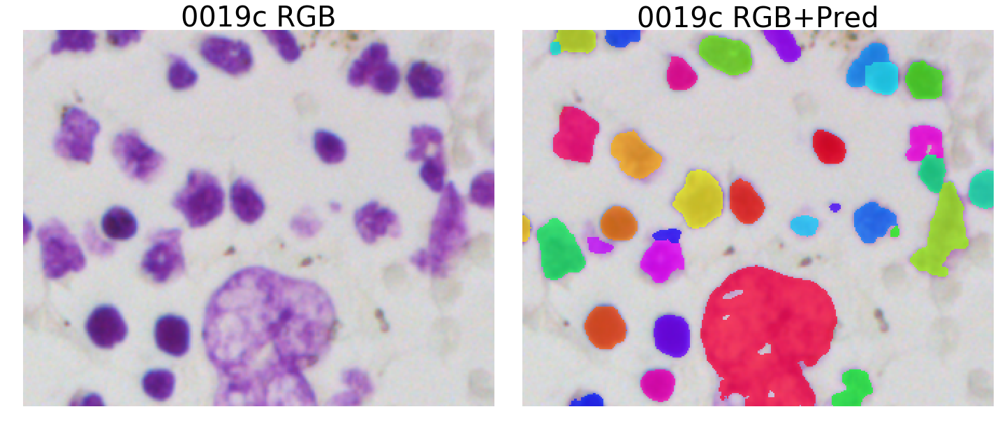

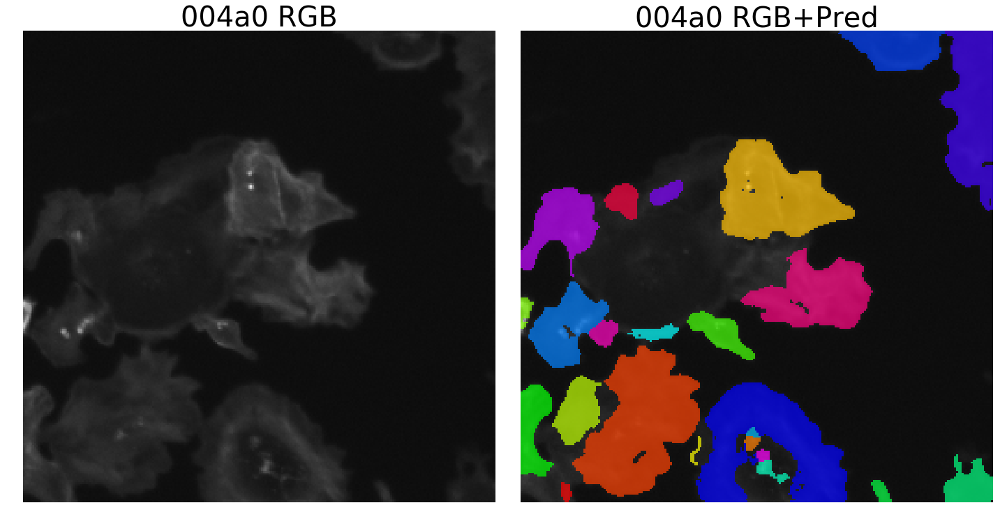

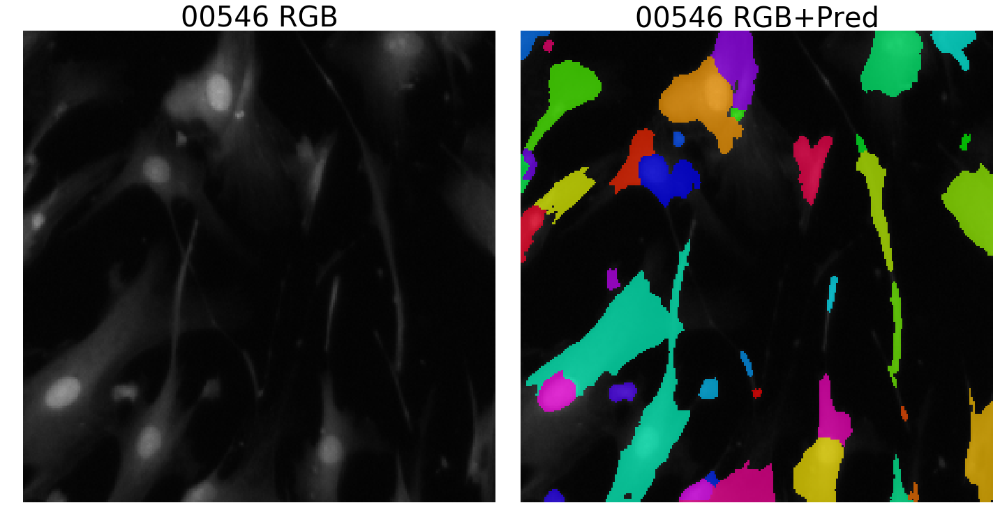

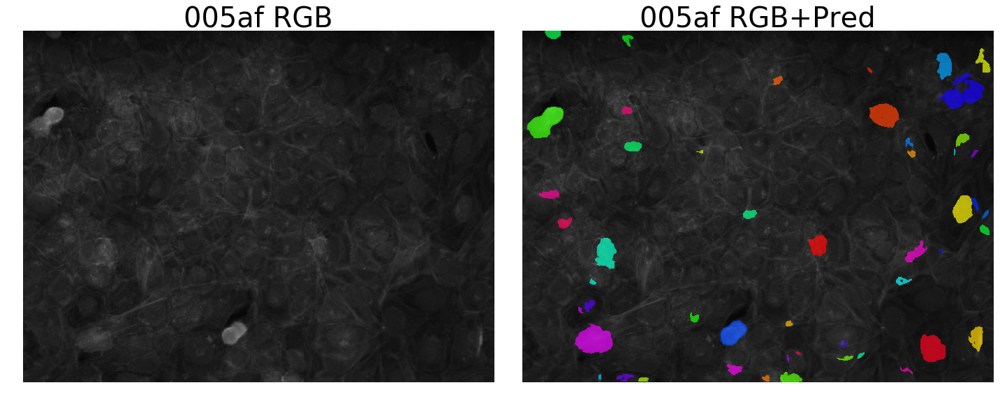

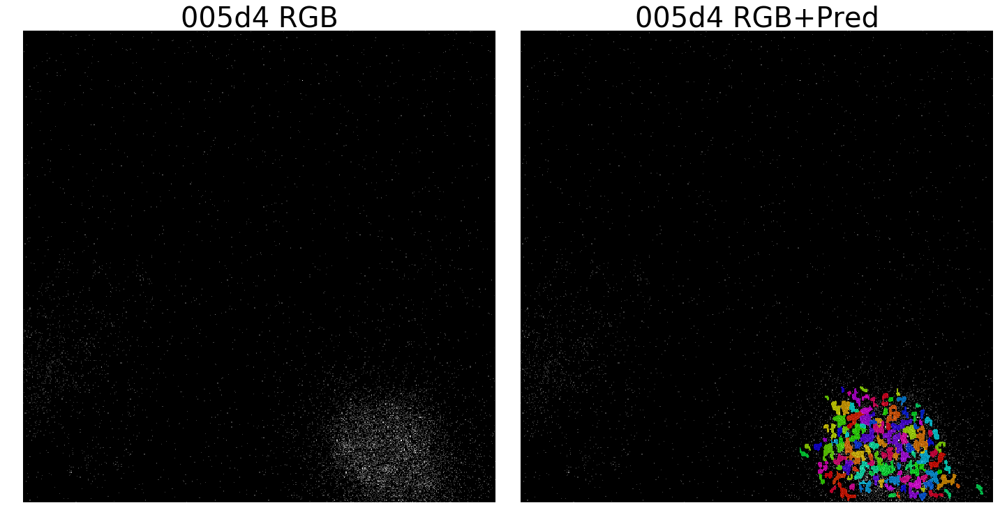

...

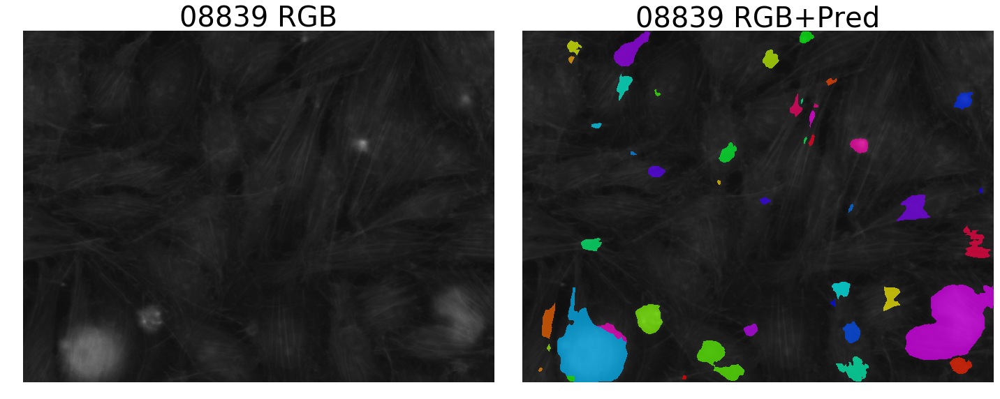

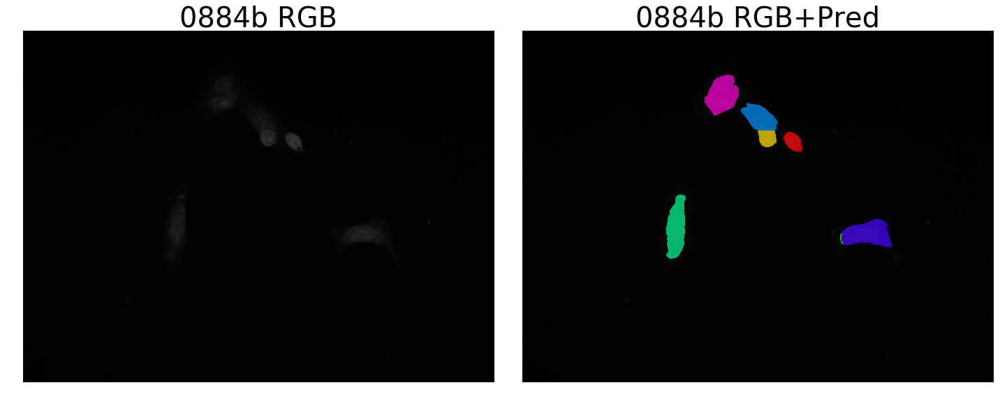

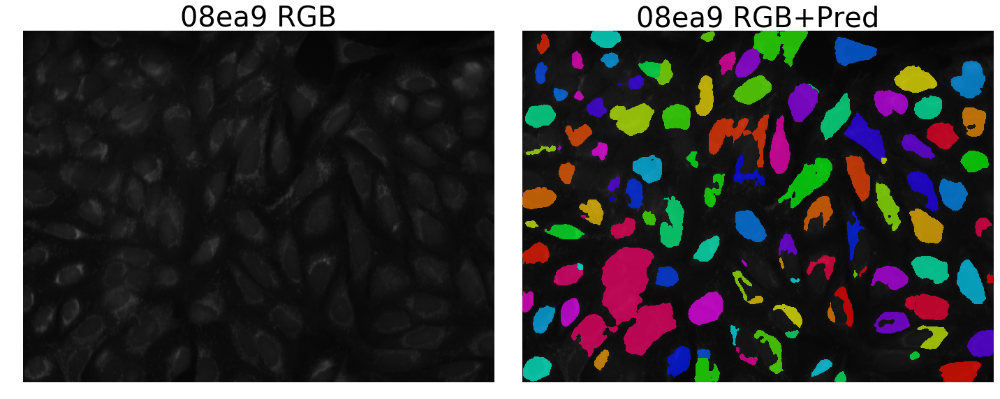

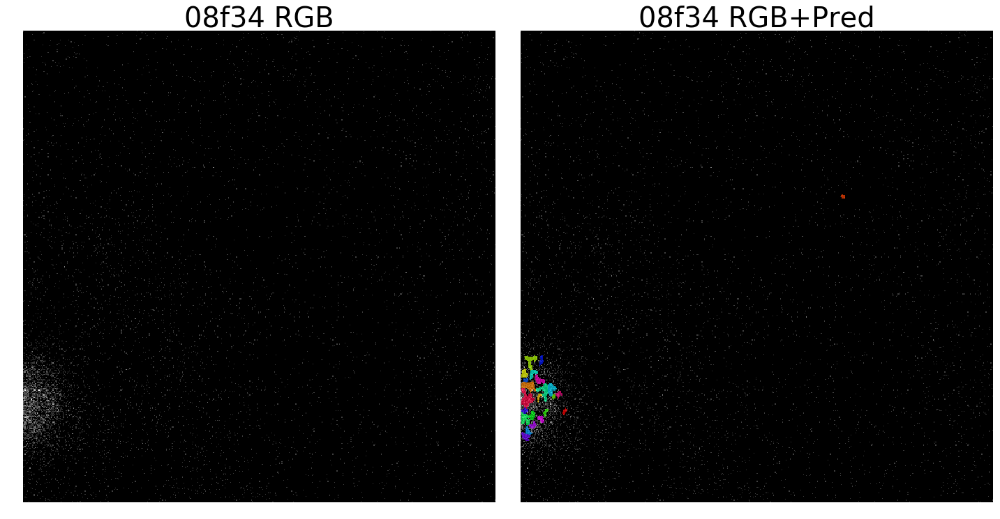

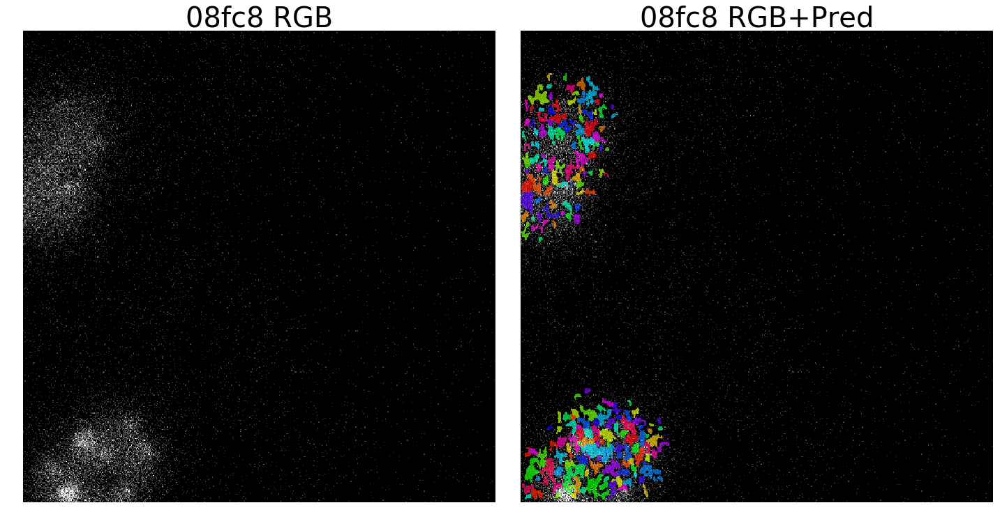

In [15]:
images, pred_inst_masks, _, IDs = ds.get_rand_samples_with_inst_masks(num_samples, 'test_with_preds', return_IDs=True, deterministic=True)
for image, pred_mask, ID in zip(images, pred_inst_masks, IDs):
    # Display two images: original RGB image and RGB image with predicted instance masks overlayed.
    # Each mask is displayed in a unique color.
    # This is useful to debug issues with instance separation.
    display_image_and_pred_masks(image, pred_mask, ID)

## Generate submission

In [10]:
# Create a Submission object
submit = DSB18Submission(ds_root=dataset_root)
submit.print_config()


Configuration:
  key                  value
  samples              3019
  output csv           E:/datasets/dsb18.retrain/submissions/inst_masks_sub_2018-04-14_03h-10m-30s.csv


In [11]:
# RLE encode predicted instance masks
submit.encode_predicted_instance_masks()

RLE encode predicted instance masks: 100%|######################| 3019/3019 [06:22<00:00,  7.89it/s]


In [12]:
# Create submission DataFrame and generate submission CSV
submit.to_csv()
print(submit.instance_masks_csv)

E:/datasets/dsb18.retrain/submissions/inst_masks_sub_2018-04-14_03h-10m-30s.csv
